# Plot results

This notebooks allows to generate comparative plots and skill maps for all the available versions saved of a model. 

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import sys
sys.path.append('/'.join(sys.path[0].split('/')[:-1]))

import xarray as xr
import matplotlib.pyplot as plt
import numpy as np
import time
import os
import healpy as hp
import random
import pickle
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import cm, colors

from modules.test import compute_rmse_healpix
from modules.full_pipeline import compute_errors, plot_climatology
from modules.plotting import plot_general_skills, plot_benchmark, plot_skillmaps, plot_benchmark_simple, plot_rmses, plot_benchmark
from modules.data import hp_to_equiangular
from modules.mail import send_info_mail


import warnings
warnings.filterwarnings("ignore")

### Define model to generate plots

In [59]:
models_to_compare = []
for ep in range(10):
    name = 'all_const_len2_delta_6_architecture_loss_v0' + \
    '_8steps_variation0_residual_only_enc_l3_per_epoch_restart9__epoch_{}'.format(ep) 
    models_to_compare.append(name)

In [60]:
description = '8steps_variation0_residual_only_enc_l3_per_epoch_restart9__'

**IMPORTANT:**

Set `compute_full_plots` to `True` if you want to generate **all** the skills plots. Otherwise only rmse comparison plots will be displayed.

In [9]:
compute_full_plots = False

#### Load data

In [61]:
datadir = "../data/healpix/"
input_dir = datadir + "5.625deg_nearest/"
model_save_path = datadir + "models/"
pred_save_path = datadir + "predictions/"
prediction_path = '../data/healpix/predictions/'

In [62]:
chunk_size = 521
len_sqce = 2
# define time resolution
delta_t = 6

# predict 5days data
max_lead_time = 5*24
in_features = 7
out_features = 2

resolution = 5.625
lead_time = 6
start_time = len_sqce * lead_time - 6
end_time = (6-lead_time) if (6-lead_time) > 0 else None

# Data
lead_times = np.arange(lead_time, max_lead_time+lead_time, lead_time)

In [63]:
preds = []
names = []
for ep, name in enumerate(models_to_compare):
    try:
        pred = xr.open_mfdataset(prediction_path  + name + '.nc', combine='by_coords', chunks={'time':chunk_size})
        preds.append(pred)
        names.append('Epoch {}'.format(ep))
    except:
        print('Epoch {} not available'.format(ep))

Epoch 0 not available
Epoch 1 not available
Epoch 2 not available
Epoch 3 not available
Epoch 4 not available
Epoch 5 not available
Epoch 6 not available
Epoch 7 not available
Epoch 8 not available
Epoch 9 not available


### Load RMSE and generate comparative plots

In [64]:
obsc = xr.open_mfdataset(prediction_path + 'observations_nearest.nc', combine='by_coords', chunks={'time':chunk_size})
#obsc = obsc.isel(time=slice(6,pred.time.shape[0]+6))

In [65]:
metrics_path = '../data/healpix/metrics/'
figures_path = '../data/healpix/figures/' + description + '/'

In [66]:
if not os.path.isdir(figures_path):
    os.mkdir(figures_path)

In [67]:
rmse_models_to_compare = []
for ep, name in enumerate(models_to_compare):
    rmse_spherical = xr.load_dataset(metrics_path + 'rmse_' + name + '.nc')
    rmse_models_to_compare.append(rmse_spherical)

In [70]:
names = ['Epoch {}'.format(ep) for ep in range(10, 20)]

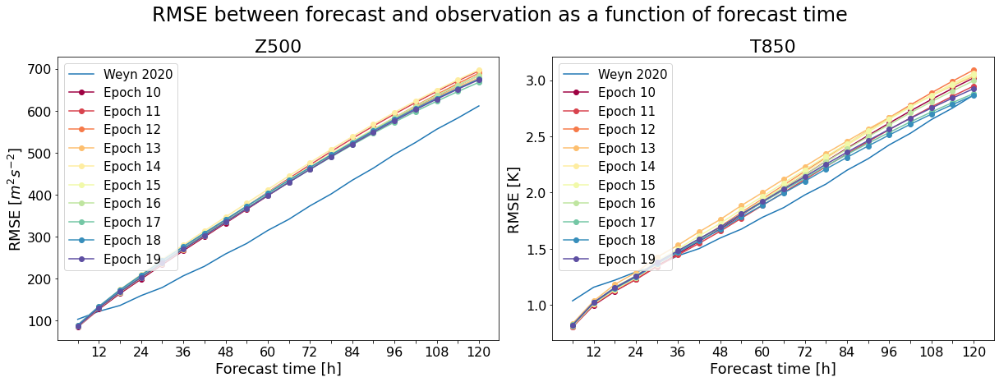

In [71]:
plot_benchmark_simple(rmse_models_to_compare, description, lead_times, input_dir=metrics_path, output_dir=figures_path, \
                          title=True, filename=description+'_comparison', names=names)

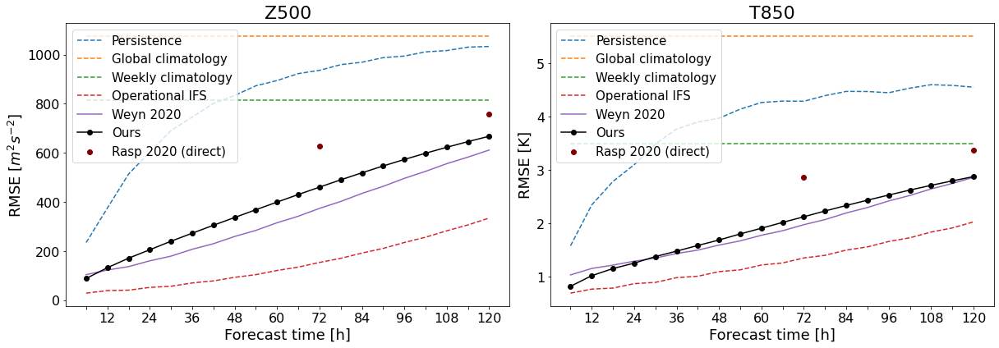

In [88]:
plot_benchmark(rmse_models_to_compare[7], description, lead_times, 
               input_dir=metrics_path, output_dir=figures_path, title=False)

In [20]:
rmses_weyn = xr.open_dataset(metrics_path + 'rmses_weyn.nc').rename({'z500':'z', 't850':'t'})

### Print results at t=6h and t=120h 

In [87]:
model = rmse_models_to_compare[7]

print('Breakeven Z500')
be_z = np.where(rmses_weyn.z.values[:len(model.z.values)] < model.z.values)
print((be_z[0][0])*6, 'h')

print('Breakeven t850')
be_t = np.where(rmses_weyn.t.values[:len(model.z.values)] < model.t.values)
print((be_t[0][0])*6, 'h')

print('Values at t=6h')
print('z500: ', model.z.values[0])
print('t850: ', model.t.values[0])

print('Values at t=120h')
print('z500: ', model.z.values[-1])
print('t850: ', model.t.values[-1])

Breakeven Z500
6 h
Breakeven t850
24 h
Values at t=6h
z500:  87.73020580928997
t850:  0.8246576945724063
Values at t=120h
z500:  667.4985575762871
t850:  2.8801029090415513


### Generate skillmaps

In [ ]:
if compute_full_plots:
    for ep, pred in enumerate(preds):
        corr_map, rbias_map, rsd_map, rmse_map, obs_rmse, rmse_map_norm = compute_errors(pred, obsc)
        rbias_spherical = rbias_map.mean('node').compute()
        rsd_spherical = rsd_map.mean('node').compute()
        corr_spherical = corr_map.mean('node').compute()
        
        plot_general_skills(rmse_map_norm, corr_map, rbias_map, rsd_map, description + '_epoch_{}'.format(ep), lead_times, 
                    output_dir=figures_path, title=False)

        plot_skillmaps(rmse_map_norm, rsd_map, rbias_map, corr_map, description + '_epoch_{}'.format(ep), lead_times, resolution, 
               output_dir=figures_path)

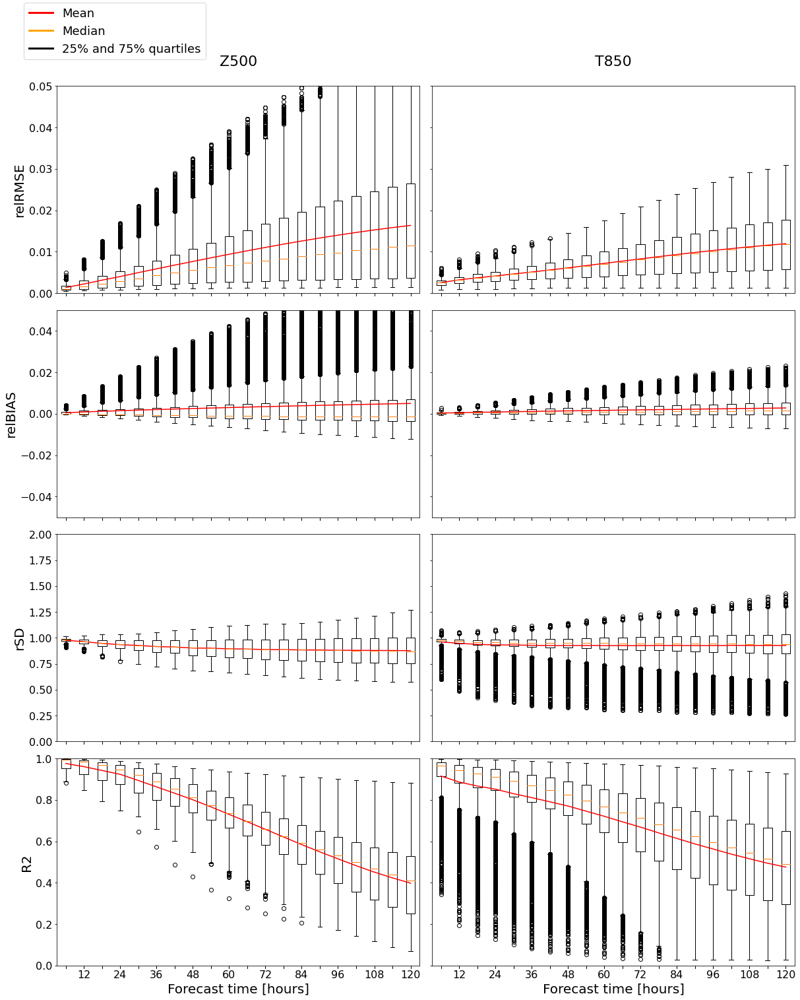

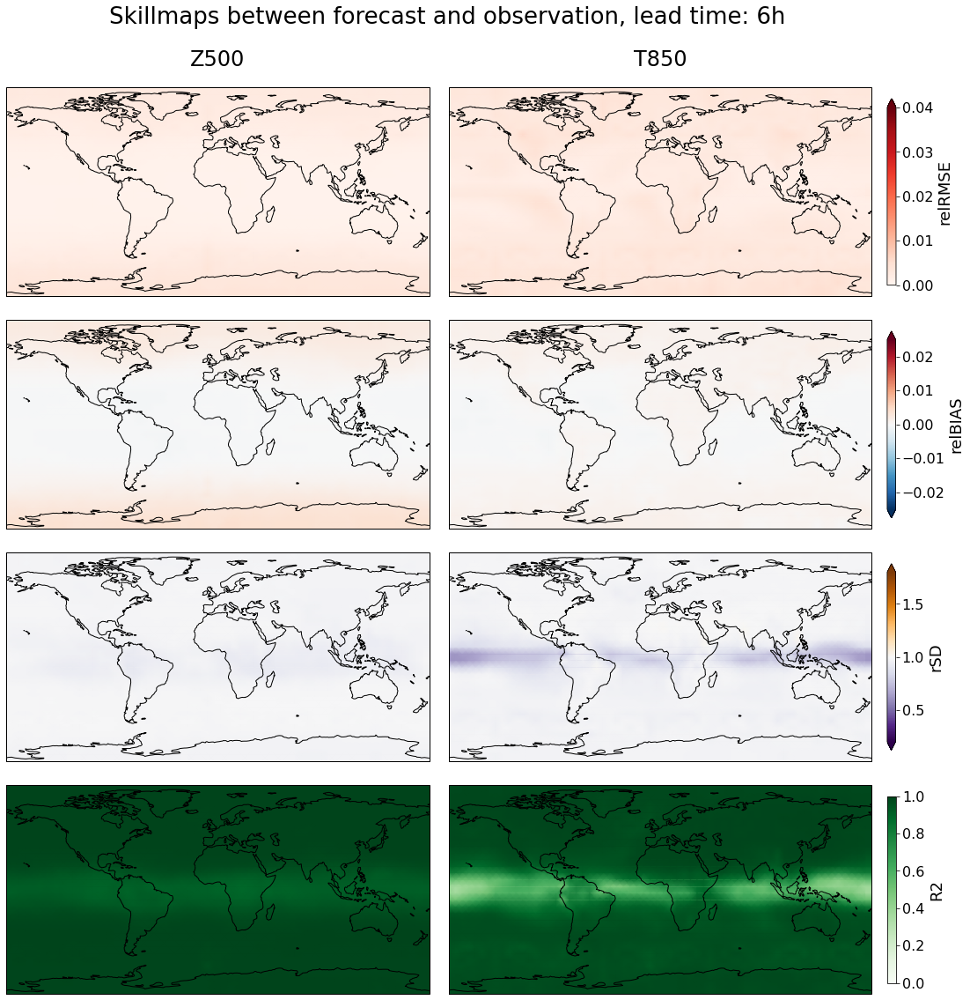

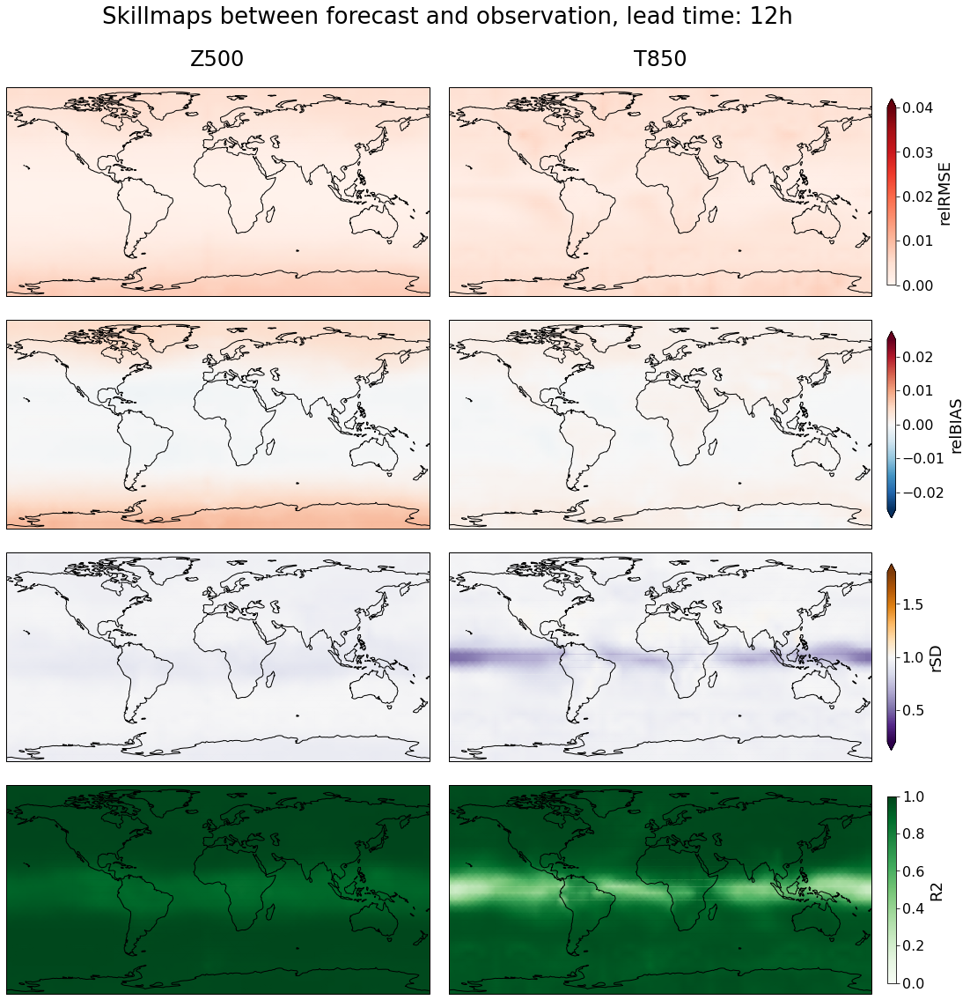

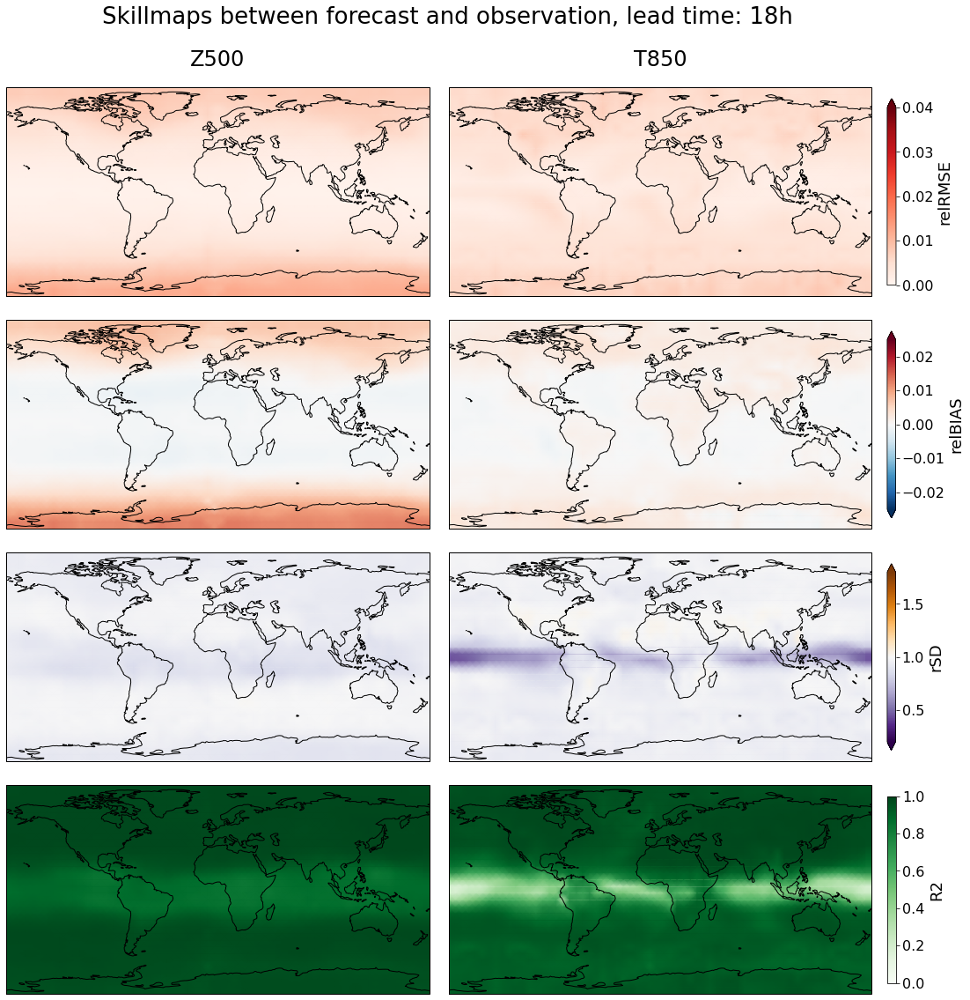

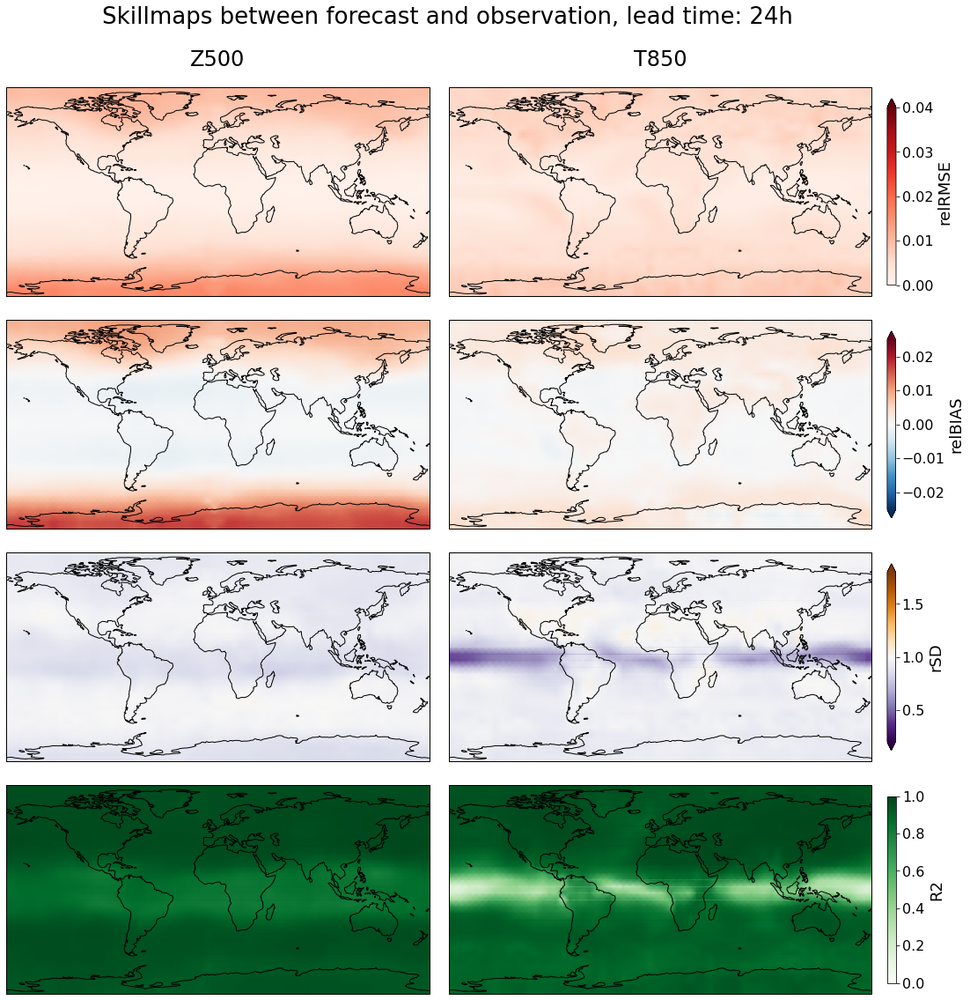

...

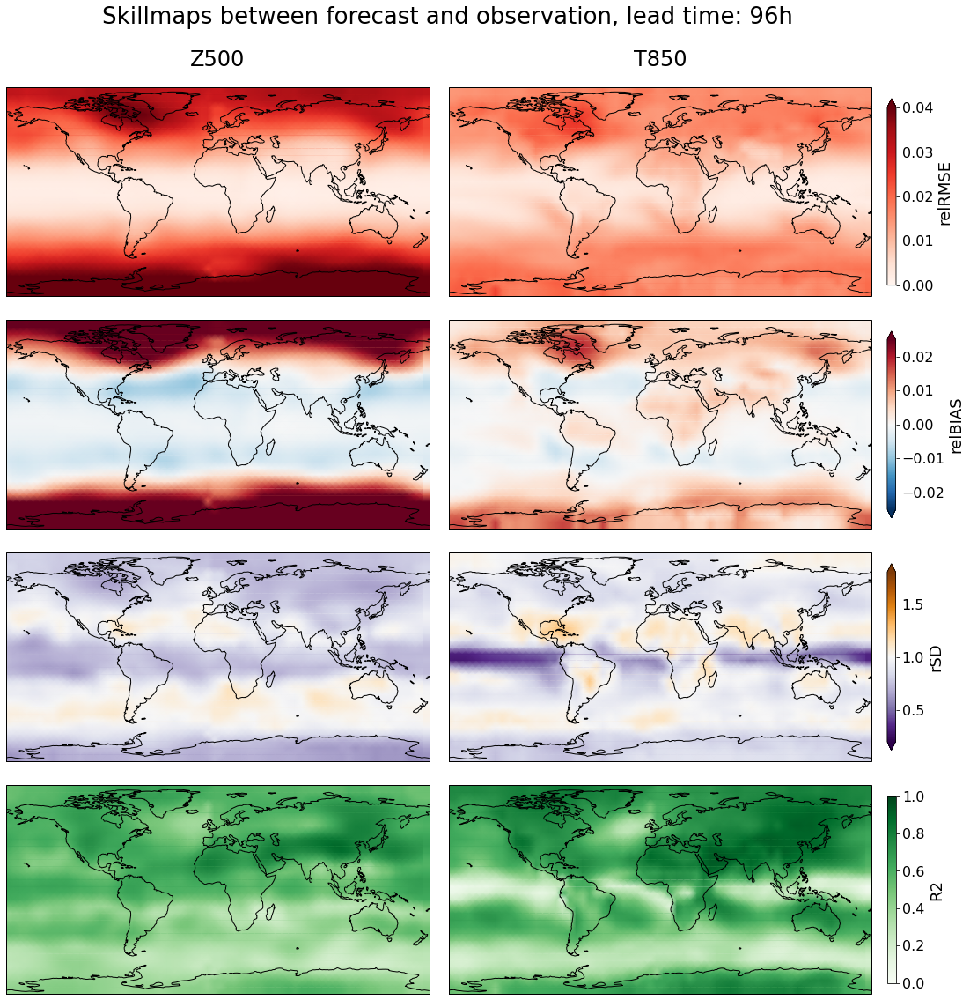

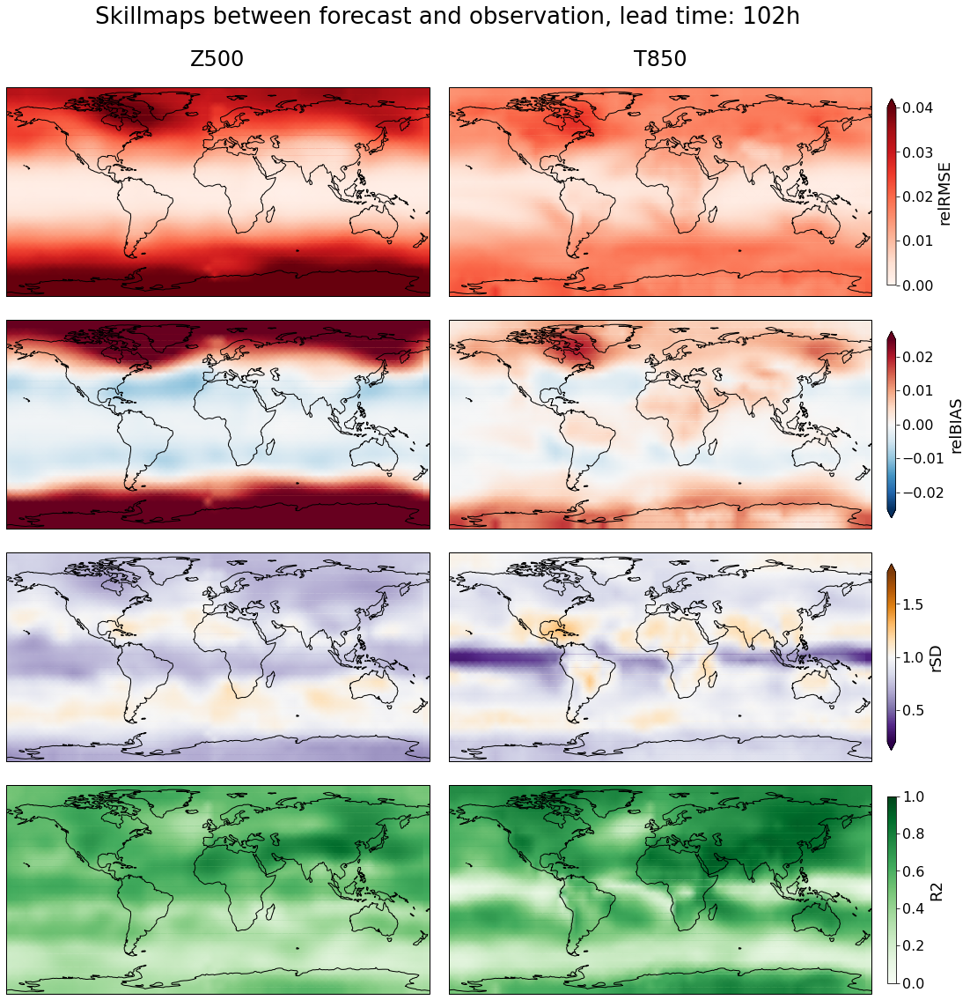

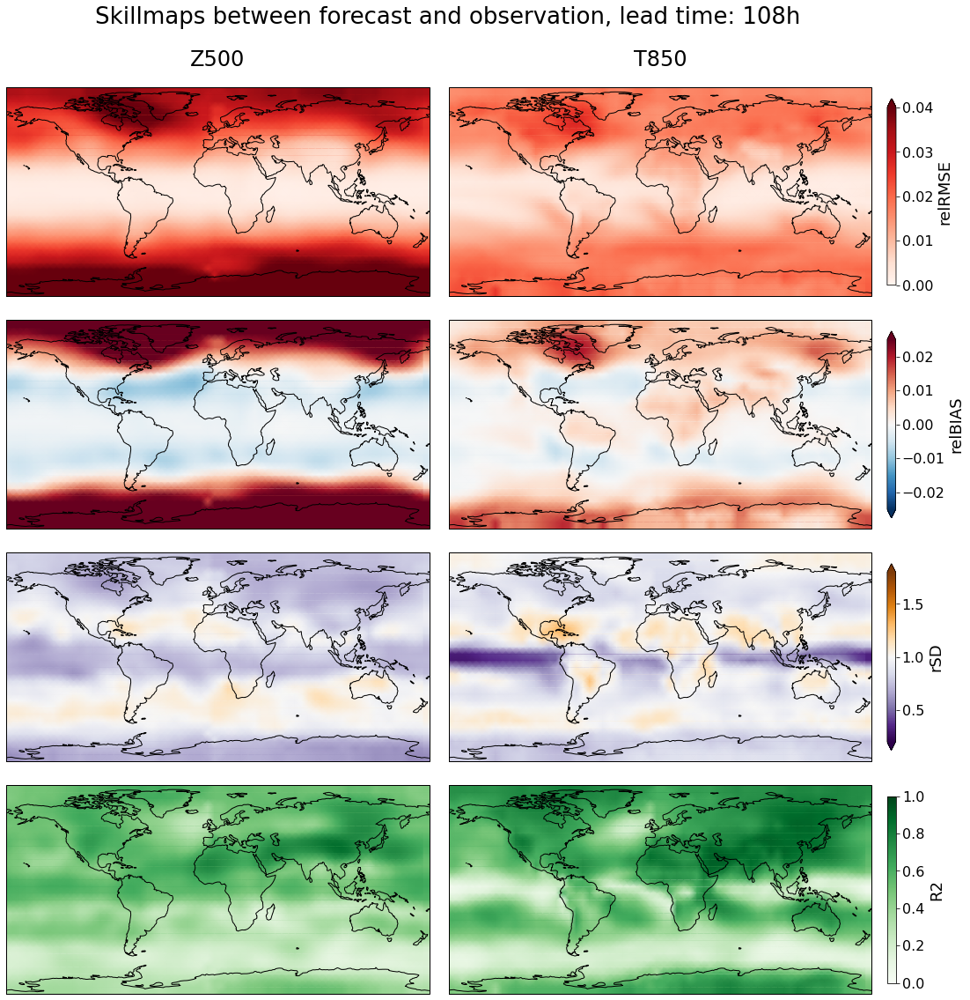

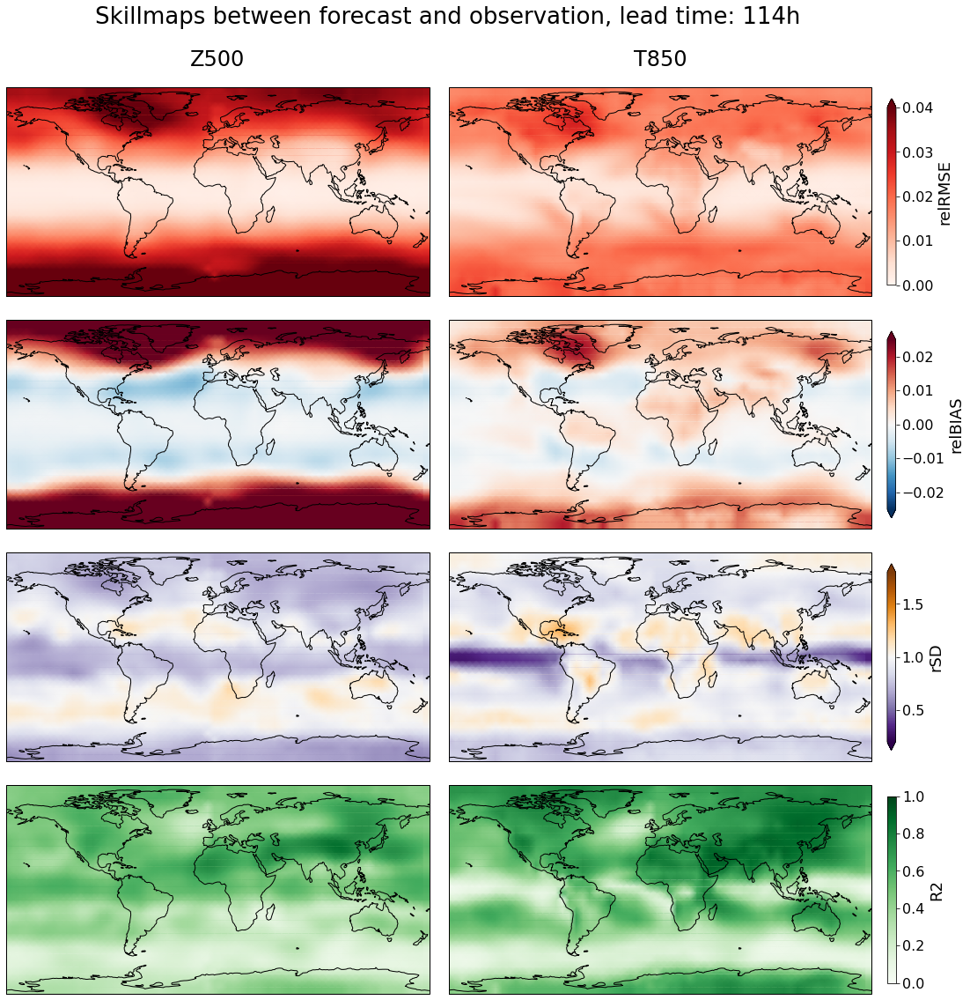

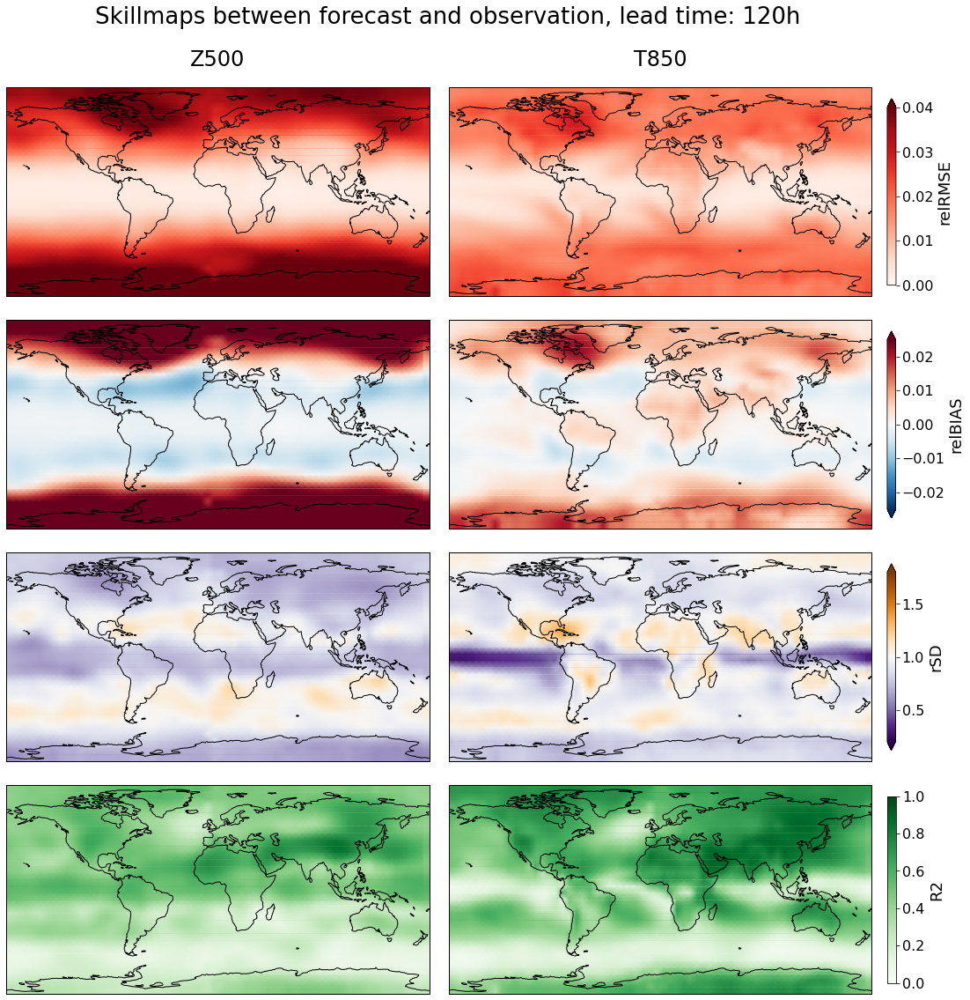

## Plots for single model (no epochs comparison)

#### Load data

In [3]:
datadir = "../data/healpix/"
input_dir = datadir + "5.625deg_nearest/"
model_save_path = datadir + "models/"
pred_save_path = datadir + "predictions/"
prediction_path = '../data/healpix/predictions/'

In [4]:
chunk_size = 521
len_sqce = 2
# define time resolution
delta_t = 6

# predict 5days data
max_lead_time = 5*24
in_features = 7
out_features = 2

resolution = 5.625
lead_time = 6
start_time = len_sqce * lead_time - 6
end_time = (6-lead_time) if (6-lead_time) > 0 else None

# Data
lead_times = np.arange(lead_time, max_lead_time+lead_time, lead_time)

In [105]:
description = 'all_const_len2_delta_6_architecture_spherical_unet_residual_short_4levels_ND_5epochs'

In [106]:
pred = xr.open_mfdataset(prediction_path  + description + '.nc', combine='by_coords', chunks={'time':chunk_size})

In [107]:
obsc = xr.open_mfdataset(prediction_path + 'observations_nearest.nc', combine='by_coords', chunks={'time':chunk_size})


In [108]:
metrics_path = '../data/healpix/metrics/'
figures_path = '../data/healpix/figures/' + description + '/'

In [109]:
if not os.path.isdir(figures_path):
    os.mkdir(figures_path)

In [110]:
rmse_spherical = xr.load_dataset(metrics_path + 'rmse_' + description + '.nc')

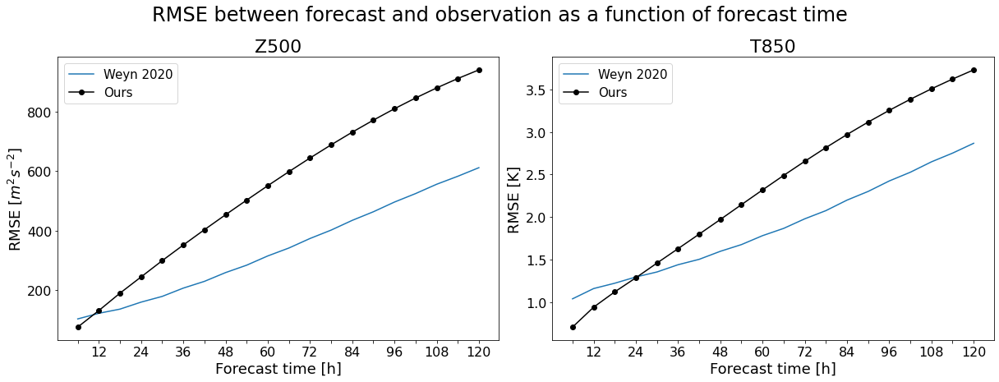

In [111]:
plot_benchmark_simple(rmse_spherical, description, lead_times, input_dir=metrics_path, output_dir=figures_path, \
                          title=True, filename=description)

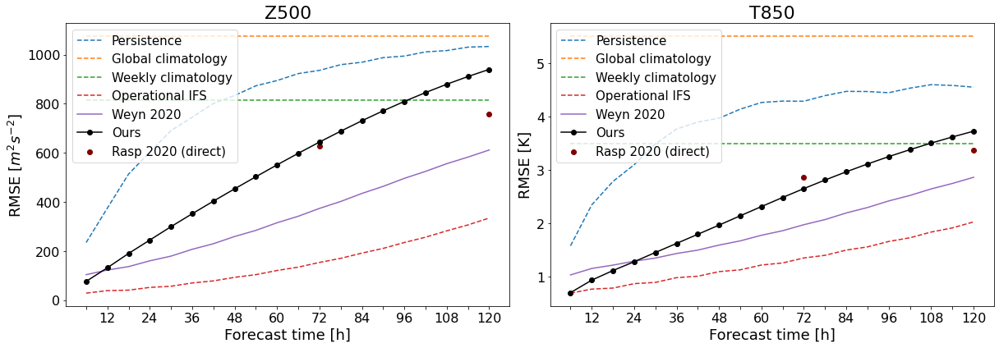

In [112]:
plot_benchmark(rmse_spherical, description, lead_times, 
               input_dir=metrics_path, output_dir=figures_path, title=False)

In [113]:
rmses_weyn = xr.open_dataset(metrics_path + 'rmses_weyn.nc').rename({'z500':'z', 't850':'t'})

### Print results at t=6h and t=120h 

In [114]:
model = rmse_spherical

print('Breakeven Z500')
be_z = np.where(rmses_weyn.z.values[:len(model.z.values)] < model.z.values)
print((be_z[0][0])*6, 'h')

print('Breakeven t850')
be_t = np.where(rmses_weyn.t.values[:len(model.z.values)] < model.t.values)
print((be_t[0][0])*6, 'h')

print('Values at t=6h')
print('z500: ', model.z.values[0])
print('t850: ', model.t.values[0])

print('Values at t=120h')
print('z500: ', model.z.values[-1])
print('t850: ', model.t.values[-1])

Breakeven Z500
6 h
Breakeven t850
24 h
Values at t=6h
z500:  75.76014335330413
t850:  0.7054962047004599
Values at t=120h
z500:  940.0021782668681
t850:  3.731179128148018
